<a href="https://colab.research.google.com/github/kalreen/FizzBuzzKata/blob/master/Pothole_detector_comparator_Phase_3_Demonstration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **POTHOLE DETECTION SYSTEM**

# **SCALED-YOLOV4 VS EFFICIENTDET MODELS IMPLEMENTING POTHOLE DETECTION**

# **GPU, CPU, DISK and RAM Information**

In [ ]:
#Execution time is printed out every cell once this is printed
!pip install ipython-autotime

%load_ext autotime

time: 1.23 ms (started: 2021-01-14 13:35:46 +00:00)


In [ ]:
# check what path is it currently on
%ls 

sample_data/


In [ ]:
#mount drive to store weights and important information as colab wipes out and loses all of its contents you program after 12 hours
from google.colab import drive
drive.mount('/content/drive/')

KeyboardInterrupt: ignored

In [ ]:
# do all the coding saving of weights, graphs on google drive under phase3 folder
%cd /content/drive/MyDrive/phase3
%ls

/content/drive/MyDrive/phase3


In [ ]:
# check memory, ram, disk space, GPU and CPU type hardware information using colabs clouds resources
!nvidia-smi -L
!lscpu |grep  'Model name:'
#no.of sockets i.e available slots for physical processors
!lscpu | grep 'Socket(s):'
#no.of cores each processor is having 
!lscpu | grep 'Core(s) per socket:'
#no.of threads each core is having
!lscpu | grep 'Thread(s) per core'
!lscpu | grep "L3 cache" 
#if it had turbo boost it would've shown Min and Max MHz also but it is only showing current frequency this means it always operates at shown frequency
!lscpu | grep "MHz"
#memory that we can use
!free -h --si | awk  '/Mem:/{print $2}'
#hard disk space that we can use
!df -h / | awk '{print $4}'


GPU 0: Tesla P100-PCIE-16GB (UUID: GPU-6e2b0cd6-99cf-1ad9-a284-0368f8c5adeb)
Model name:          Intel(R) Xeon(R) CPU @ 2.00GHz
Socket(s):           1
Core(s) per socket:  1
Thread(s) per core:  2
L3 cache:            39424K
CPU MHz:             2000.152
13G
Avail
37G


# **Data Preparation and generating of csv files from textfiles to Tf.record files for test.record and train.record**

In [ ]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os


In [ ]:
import re
##split the text file to be used as csv
def parse_txt_file(filepath, filename):
    """Parse the txt file containing image relative paths, name, and boxes data to a list """
    file = open(filepath + filename)
    items = file.read().strip().split("\n")
    item_regex = r'(^[\w\s]+\\(?:[\w\s]+\\)*G\d+\.bmp)\s+(\d+)\s+((?:\d+\s+\d+\s+\d+\s+\d+\s*)+)'
    
    def parse_item(item):
        match = re.match(item_regex, item)
        img_path = match.group(1).replace('.bmp', '.JPG') #txt says bmp but images are actually jpg
        img_name = re.search(r'G\d+\.JPG', img_path).group()
        num_boxes = int(match.group(2))
        values = re.findall(r'\d+', match.group(3))
        boxes = [tuple([ int(values[i*4+j]) for j in range(0,4)]) for i in range(0,num_boxes)]
        
        return img_name,num_boxes,boxes
    
    return [parse_item(item) for item in items]

# Code to Upload pothole dataset from Kaggle directly to save time








In [ ]:
%ls

sample_data/


In [ ]:
#install kaggle to directly download large datasets off the kaggle
!pip install kaggle

In [ ]:
# upload files to google colaboratory , upload kaggle file
from google.colab import files

uploaded = files.upload()

Saving kaggle.json to kaggle.json


In [ ]:
# make kaggle folder in the root directory and copy kaggle.json file into this folder and give write permissions otherwise kaggle does not work if it is not in root directory
!mkdir -p ~/.kaggle 
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json 

In [ ]:
# downloading simplex pothole dataset directly from kaggle
#!kaggle datasets download -d sovitrath/road-pothole-images-for-pothole-detection
!kaggle datasets download -d felipemuller5/nienaber-potholes-2-complex

100% 32.7G/32.7G [09:26<00:00, 28.3MB/s]
100% 32.7G/32.7G [09:26<00:00, 62.0MB/s]


In [ ]:
%ls

kaggle.json  nienaber-potholes-2-complex.zip  sample_data/


In [ ]:
#unzip the large dataset downlaoded from kaggle and download at a specific folder
import zipfile
!unzip /content/nienaber-potholes-2-complex.zip -d /content/extract/
#delete zip file takes up space and no need for it
!rm -rf /content/nienaber-potholes-2-complex.zip


Streaming output truncated to the last 5000 lines.
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041005.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041006.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041007.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041008.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041009.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041010.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041054.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Negative data/G0041055.JPG  
  inflating: /content/extract/dataset 2 (complex)/Dataset 2 (Complex)

In [ ]:
%ls

extract/  kaggle.json  sample_data/


In [ ]:
# removing file directories with contents
from shutil import rmtree

rmtree('/content/extract/Dataset 2 (Complex)')

### CSV file creation

In [ ]:
##the images are split into based on their number of boxes and their dimension

#text_Extract=parse_txt_file('/kaggle/input/nienaber-potholes-2-complex/Dataset 2 (Complex)/','complexTestFullSizeAllPotholes.txt')
text_Extract=parse_txt_file('/content/extract/dataset 2 (complex)/Dataset 2 (Complex)/','complexTrainFullSizeAllPotholes.txt')

df_data=pd.DataFrame(text_Extract)
df_data.columns=['Image','count','Dim']
df_data=df_data.explode('Dim')
df_data.reset_index(inplace=True,drop=True)
df_data.head()

,Image,count,Dim
0,G0010759.JPG,1,"(2008, 1460, 66, 24)"
1,G0010760.JPG,1,"(2224, 1502, 70, 28)"
2,G0010761.JPG,1,"(2630, 1564, 88, 32)"
3,G0010762.JPG,1,"(3270, 1668, 112, 46)"
4,G0010763.JPG,2,"(486, 1470, 118, 32)"


In [ ]:
##splitting x,y,w,h seperately 
dummy=pd.DataFrame(df_data.Dim.tolist(), index= df_data.index)
df_data_2=pd.concat([df_data.drop('Dim',1),dummy],axis=1)
df_data_2.columns=['filename','count','xmin','ymin','w','h']
df_data_2['class']='pothole'
df_data_2.head()

,filename,count,xmin,ymin,w,h,class
0,G0010759.JPG,1,2008,1460,66,24,pothole
1,G0010760.JPG,1,2224,1502,70,28,pothole
2,G0010761.JPG,1,2630,1564,88,32,pothole
3,G0010762.JPG,1,3270,1668,112,46,pothole
4,G0010763.JPG,2,486,1470,118,32,pothole


In [ ]:
##the box are converting into diagonal point xmax,ymax,xmin,ymin
df_data_2['xmax'] = df_data_2['xmin'] + df_data_2['w']
df_data_2['ymax'] = df_data_2['ymin'] + df_data_2['h']
df_data_2.head()

,filename,count,xmin,ymin,w,h,class,xmax,ymax
0,G0010759.JPG,1,2008,1460,66,24,pothole,2074,1484
1,G0010760.JPG,1,2224,1502,70,28,pothole,2294,1530
2,G0010761.JPG,1,2630,1564,88,32,pothole,2718,1596
3,G0010762.JPG,1,3270,1668,112,46,pothole,3382,1714
4,G0010763.JPG,2,486,1470,118,32,pothole,604,1502


In [ ]:
df_data_2.shape

(3074, 9)

In [ ]:
## write it to csv
df_data_2.to_csv('train.csv',index=False)

### TF record conversion

In [ ]:
!pip install tensorflow-object-detection-api

     |████████████████████████████████| 583kB 8.7MB/s 
     |████████████████████████████████| 61kB 5.9MB/s 
     |████████████████████████████████| 51kB 4.8MB/s 
     |████████████████████████████████| 2.6MB 13.4MB/s 
  Created wheel for tensorflow-object-detection-api: filename=tensorflow_object_detection_api-0.1.1-cp36-none-any.whl size=844516 sha256=2abbd0006ee6cace8e4372efc74088fc7ec8b6ed40d5239d0909753a981ddd8d
  Stored in directory: /root/.cache/pip/wheels/4a/54/d0/cfca11930c4b2025d40dede77059094070a67cc3e7bd3b285f
Successfully built tensorflow-object-detection-api


In [ ]:
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import os
import io
import pandas as pd
import tensorflow as tf

from PIL import Image
from object_detection.utils import dataset_util
from collections import namedtuple, OrderedDict


In [ ]:
##label to index coversion , the label will be written as number and the text
def class_text_to_int(row_label):
    if row_label == 'pothole':
        return 1
    else:
        None



def split(df, group):
    data = namedtuple('data', ['filename', 'object'])
    gb = df.groupby(group)
    return [data(filename, gb.get_group(x)) for filename, x in zip(gb.groups.keys(), gb.groups)]


##each image is serialised, along with the parameters in the csv
def create_tf_example(group, path):
    with tf.compat.v1.gfile.GFile(os.path.join(path, '{}'.format(group.filename)), 'rb') as fid:
        encoded_jpg = fid.read()
    encoded_jpg_io = io.BytesIO(encoded_jpg)
    image = Image.open(encoded_jpg_io)

    width, height = image.size

    filename = group.filename.encode('utf8')
    print(filename)
    image_format = b'jpg'
    xmins = []
    xmaxs = []
    ymins = []
    ymaxs = []
    classes_text = []
    classes = []

    for index, row in group.object.iterrows():
        xmins.append(row['xmin'] / width)
        xmaxs.append(row['xmax'] / width)
        ymins.append(row['ymin'] / height)
        ymaxs.append(row['ymax'] / height)
        classes_text.append(row['class'].encode('utf8'))
        classes.append(class_text_to_int(row['class']))

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': dataset_util.int64_feature(height),
        'image/width': dataset_util.int64_feature(width),
        'image/filename': dataset_util.bytes_feature(filename),
        'image/source_id': dataset_util.bytes_feature(filename),
        'image/encoded': dataset_util.bytes_feature(encoded_jpg),
        'image/format': dataset_util.bytes_feature(image_format),
        'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
        'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
        'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
        'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
        'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
        'image/object/class/label': dataset_util.int64_list_feature(classes),
    }))
    return tf_example

In [ ]:
###conversion to tfrecord

##specify the directory where images are
image_dir='/content/extract/dataset 2 (complex)/Dataset 2 (Complex)/Train data/Positive data'

##change the out file here
output_file_path='train.tfrecord'
writer = tf.compat.v1.python_io.TFRecordWriter(output_file_path)

##read in the saved csv(uncomment below)
# df_data_2=pd.read_csv('train.csv')

path = os.path.join(image_dir)
##group based on filename 
grouped = split(df_data_2, 'filename')

file_errors = 0

#files are written one at a time
for group in grouped:
    try:
        tf_example = create_tf_example(group, path)
        writer.write(tf_example.SerializeToString())
    except:

        file_errors +=1
        pass

writer.close()

print("FINISHED. There were %d errors" %file_errors)

b'G0010759.JPG'
b'G0010760.JPG'
b'G0010761.JPG'
b'G0010762.JPG'
b'G0010763.JPG'
b'G0010764.JPG'
b'G0010765.JPG'
b'G0010766.JPG'
b'G0010767.JPG'
b'G0010768.JPG'
b'G0010769.JPG'
b'G0010770.JPG'
b'G0010813.JPG'
b'G0010814.JPG'
b'G0010815.JPG'
b'G0011195.JPG'
b'G0011196.JPG'
b'G0011242.JPG'
b'G0011243.JPG'
b'G0011244.JPG'
b'G0011427.JPG'
b'G0011472.JPG'
b'G0011473.JPG'
b'G0011474.JPG'
b'G0011475.JPG'
b'G0011476.JPG'
b'G0011477.JPG'
b'G0011488.JPG'
b'G0011489.JPG'
b'G0011490.JPG'
b'G0011491.JPG'
b'G0011492.JPG'
b'G0011493.JPG'
b'G0011494.JPG'
b'G0011495.JPG'
b'G0011496.JPG'
b'G0011503.JPG'
b'G0011504.JPG'
b'G0011505.JPG'
b'G0011506.JPG'
b'G0011507.JPG'
b'G0011523.JPG'
b'G0011524.JPG'
b'G0011525.JPG'
b'G0011526.JPG'
b'G0011527.JPG'
b'G0011528.JPG'
b'G0011529.JPG'
b'G0011555.JPG'
b'G0011556.JPG'
b'G0011558.JPG'
b'G0011559.JPG'
b'G0011560.JPG'
b'G0011561.JPG'
b'G0011562.JPG'
b'G0011563.JPG'
b'G0011564.JPG'
b'G0011566.JPG'
b'G0011567.JPG'
b'G0011569.JPG'
b'G0011570.JPG'
b'G0011572.JPG'
b'G00115

# **Pothole Detection on EfficientDET Model** 

Install TensorFlow2 Object Detection Dependencies with GPU

In [ ]:
# Google colab comes with tensorflow 2.4.0 preinstalled uninstall to eliminate conflict of tensorflow versions
!pip uninstall tensorflow_gpu=="2.4.0"
!pip uninstall tensorflow=="2.2.0"

Uninstalling tensorflow-gpu-2.2.0:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.6/dist-packages/tensorflow/*
    /usr/local/lib/python3.6/dist-packages/tensorflow_gpu-2.2.0.dist-info/*
  Would not remove (might be manually added):
    /usr/local/lib/python3.6/dist-packages/tensorflow/_api/v2/__internal__/__init__.py
    /usr/local/lib/python3.6/dist-packages/tensorflow/_api/v2/__internal__/decorator/__init__.py
    /usr/local/lib/python3.6/dist-packages/tensorflow/_api/v2/__internal__/distribute/__init__.py
    /usr/local/lib/python3.6/dist-packages/tensorflow/_api/v2/__internal__/distribute/combinations/__init__.py
    /usr/local/lib/python3.6/dist-packages/tensorflow/_api/v2/__internal__/distribute/multi_process_runner/__init__.py
    /usr/local/lib/pyt

In [ ]:
#install tensorflow with GPU version 2.2.0
!pip install tensorflow_gpu=="2.2.0"


  Using cached https://files.pythonhosted.org/packages/31/bf/c28971266ca854a64f4b26f07c4112ddd61f30b4d1f18108b954a746f8ea/tensorflow_gpu-2.2.0-cp36-cp36m-manylinux2010_x86_64.whl
  Using cached https://files.pythonhosted.org/packages/a4/f5/926ae53d6a226ec0fda5208e0e581cffed895ccc89e36ba76a8e60895b78/tensorflow_estimator-2.2.0-py2.py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/1d/74/0a6fcb206dcc72a6da9a62dd81784bfdbff5fedb099982861dc2219014fb/tensorboard-2.2.2-py3-none-any.whl
  Found existing installation: tensorflow-estimator 2.4.0
    Uninstalling tensorflow-estimator-2.4.0:
      Successfully uninstalled tensorflow-estimator-2.4.0
  Found existing installation: tensorboard 2.4.0
    Uninstalling tensorboard-2.4.0:
      Successfully uninstalled tensorboard-2.4.0
time: 1min 17s (started: 2021-01-13 14:28:59 +00:00)


In [ ]:
#check installed tensorflow version
import tensorflow as tf
print (tf.__version__)

2.4.0


In [ ]:
# check what files are installed in path directory
%ls

models/             README.roboflow.txt  test/   training/
README.dataset.txt  sample_data/         train/  valid/
time: 124 ms (started: 2021-01-13 14:30:29 +00:00)


In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist efficientdet lies in this folder this is why it is needed
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 2399, done.
remote: Counting objects: 100% (2399/2399), done.
remote: Compressing objects: 100% (1994/1994), done.
remote: Total 2399 (delta 559), reused 1460 (delta 378), pack-reused 0
Receiving objects: 100% (2399/2399), 30.77 MiB | 35.52 MiB/s, done.
Resolving deltas: 100% (559/559), done.


In [ ]:
#check if tensorflow models folder is cloned and stored on colab path directory
%ls 

extract/              road-pothole-images-for-pothole-detection.zip
generate_tfrecord.py  sample_data/
kaggle.json           trialcsv.csv
models/


In [ ]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp36-none-any.whl size=1608663 sha256=23f2460914cc43238cdabd47709e0edec6aaadd2b5af0782c815fcac9d378cf4
  Stored in directory: /tmp/pip-ephem-wheel-cache-xk6fa11b/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
  Created wheel for avro-python3: filename=avro_python3-1.10.1-cp36-none-any.whl size=43734 sha256=dc4b5f5290cebf755603684719270519e137f2735beede8cdae09e0f309823a1
  Stored in directory: /root/.cache/pip/wheels/65/fe/90/20d6d6d97223d80d20cb390be636619c536edab5658c12bdba
  Created wheel for hdfs: filename=hdfs-2.5.8-cp36-none-any.whl size=33213 sha256=b6bb4b497be8dcf727d85c33a00586e3f78e06913d48c7535f39a80cfb49efb6
  Stored in directory: /root/.cache/pip/wheels/fe/a7/05/23e3699975fc20f8a30e00ac1e515ab8c61168e982abe4ce70
  Created wheel for dill: filename=dill-0.3.1.1-cp36-none-any.whl size=78533 sha256=4bab2ea1c5b2127bebdc917a088d02a059d5e20ca420a61667861960c6

ERROR: multiprocess 0.70.11.1 has requirement dill>=0.3.3, but you'll have dill 0.3.1.1 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.25.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: apache-beam 2.27.0 has requirement avro-python3!=1.9.2,<1.10.0,>=1.8.1, but you'll have avro-python3 1.10.1 which is incompatible.


In [ ]:
#all imports and files used
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util # works for tensorflow_gpu==2.4.0 but for tensorflow_gpu==2.2.0 throws a keras error but 2.4.0 doesnt allow for training
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

time: 457 ms (started: 2021-01-13 14:30:43 +00:00)


In [ ]:
#run model builder test to verify if object detection API is setup and installed correctly
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py


2021-01-14 12:56:13.691617: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Running tests under Python 3.6.9: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-01-14 12:56:16.701586: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-01-14 12:56:16.702809: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-01-14 12:56:16.751365: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-01-14 12:56:16.751950: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

In [ ]:
# WE NEED TO CHANGE THIS TO GENERATE OUR OWN TF.RECORD FILES (TRAIN.RECORD, TEST.RECORD) AND POTHOLES_LABEL_MAP_PBTXT FILE

#Downloading data from Roboflow - NEED TO CHANGE AT THIS POINT  NEED TO ADD GENERATE_TFRECORD.PY COMMAND  
#!python generate_tfrecord.py --csv_input=images/train_df.csv --image_dir=images/train --output_path=train.record
#!python generate_tfrecord.py --csv_input=images/test_df.csv --image_dir=images/test --output_path=test.record
%cd /content
#TRYING POTHOLE DATASET
!curl -L "https://public.roboflow.com/ds/4gXbt5g2hw?key=gys2vAVmM9" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   891  100   891    0     0   1054      0 --:--:-- --:--:-- --:--:--  1053
100 45.9M  100 45.9M    0     0  17.3M      0  0:00:02  0:00:02 --:--:--  113M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: test/potholes.tfrecord  
 extracting: test/potholes_label_map.pbtxt  
 extracting: train/potholes.tfrecord  
 extracting: train/potholes_label_map.pbtxt  
 extracting: valid/potholes.tfrecord  
 extracting: valid/potholes_label_map.pbtxt  


In [ ]:
#  TFRecord to your files giving a variable name to record files and label_map file
#test_record_fname = '/content/valid/potholes.tfrecord'
#train_record_fname = '/content/train/potholes.tfrecord'
train_record_name='/content/train.record'
label_map_pbtxt_fname = '/content/train/potholes_label_map.pbtxt'

# Configure Custom TensorFlow2 Object Detection for training





>



In [ ]:
##change chosen model to deploy different models available in the TF2 object detection zoo
#NOT SURE WHY THE MOMENT I CHANGE MODEL TO EFFICIENT-D1 ONWARDS IT DOES NOT TRAIN
MODELS_CONFIG = {
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d1': {
        'model_name': 'efficientdet_d1_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d1_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d2': {
        'model_name': 'efficientdet_d2_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d2_768x768_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d2_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
        'efficientdet-d3': {
        'model_name': 'efficientdet_d3_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d3_896x896_coco17_tpu-32.config',
        'pretrained_checkpoint': 'efficientdet_d3_coco17_tpu-32.tar.gz',
        'batch_size': 16
    }
}

#in this demonstration we implement the lightweight, smallest state of the art efficientdet model
#if you want to scale up tot larger efficientdet models you will likely need more compute!
chosen_model = 'efficientdet-d0'

num_steps = 4000#The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing. Did a few steps to see if training runs
num_eval_steps = 500 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] #if you can fit a large batch in memory, it may speed up your training

In [ ]:
#download pretrained weights for transfer learning applied
%mkdir /content/models/research/deploy/
%cd /content/models/research/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

mkdir: cannot create directory ‘/content/models/research/deploy/’: File exists
/content/models/research/deploy
--2021-01-13 18:06:53--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 108.177.126.128, 2a00:1450:4013:c01::80
Connecting to download.tensorflow.org (download.tensorflow.org)|108.177.126.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz.11’

efficientdet_d0_coc 100%[===================>]  29.31M  91.6MB/s    in 0.3s    

2021-01-13 18:06:53 (91.6 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz.11’ saved [30736482/30736482]



In [ ]:
#download base training configuration file
%cd /content/models/research/deploy
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/content/models/research/deploy
--2021-01-13 18:06:57--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config.11’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2021-01-13 18:06:57 (78.1 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config.11’ saved [4630/4630]



In [ ]:
#prepare
pipeline_fname = '/content/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)


In [ ]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re

%cd /content/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    
    #fine-tune checkpoint type
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)
        
    f.write(s)



/content/models/research/deploy
writing custom configuration file


In [ ]:
# displaying pipline_file.config config file of all the model hyperparameters values and features set to before training process can begin
%cat /content/models/research/deploy/pipeline_file.config

 # SSD with EfficientNet-b0 + BiFPN feature extractor,
# shared box predictor and focal loss (a.k.a EfficientDet-d0).
# See EfficientDet, Tan et al, https://arxiv.org/abs/1911.09070
# See Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from an EfficientNet-b0 checkpoint.
#
# Train on TPU-8

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 1
    add_background_class: false
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      m

In [ ]:
# setting variables to paths for preparation of training with each field below stating its definition in the text box
pipeline_file = '/content/models/research/deploy/pipeline_file.config'
model_dir = '/content/training/'



* pipeline_file: defined above in writing custom training configuration
* model_dir: the location tensorboard logs and saved model checkpoints will save to
* num_train_steps: how long to train for
* num_eval_steps: perform eval on validation set after this many steps







In [ ]:
# begin training here according to config file hyperparameters , number of steps, number of evaluation steps etc when training begins successfully should see loss function decreasing

!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2021-01-13 18:07:18.418057: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2021-01-13 18:07:18.439538: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-01-13 18:07:18.440088: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-01-13 18:07:18.440588: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2021-01-13 18:07:18.443935: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10
2021-01-13 18:07:18.447032: I tensorflow/stream_executor/plat

In [ ]:
#run model evaluation to obtain performance metrics
#!python /content/models/research/object_detection/model_main_tf2.py \
    #--pipeline_config_path={pipeline_file} \
    #--model_dir={model_dir} \
    #--checkpoint_dir={model_dir} \
#Not yet implemented for EfficientDet

In [ ]:

%reload_ext tensorboard
%tensorboard --logdir '/content/training/train'


Reusing TensorBoard on port 6007 (pid 42827), started 0:16:13 ago. (Use '!kill 42827' to kill it.)

<IPython.core.display.Javascript object>

## Exporting a Trained Inference Graph
Still to come for TF2 models, we will be updating this Colab notebook accordingly as the functionality is added. 

In [ ]:
#see where our model saved weights
%ls '/content/training/'

checkpoint                  ckpt-2.data-00001-of-00002  ckpt-3.index
ckpt-1.data-00000-of-00001  ckpt-2.index                train/
ckpt-1.index                ckpt-3.data-00000-of-00002
ckpt-2.data-00000-of-00002  ckpt-3.data-00001-of-00002
time: 118 ms (started: 2021-01-13 14:53:47 +00:00)


In [ ]:
#run conversion script
import re
import numpy as np

output_directory = '/content/fine_tuned_model'

#place the model weights you would like to export here
last_model_path = '/content/training/'
print(last_model_path)
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/content/training/
I0113 15:03:43.467798 140078889826176 ssd_efficientnet_bifpn_feature_extractor.py:144] EfficientDet EfficientNet backbone version: efficientnet-b0
I0113 15:03:43.467961 140078889826176 ssd_efficientnet_bifpn_feature_extractor.py:145] EfficientDet BiFPN num filters: 64
I0113 15:03:43.468033 140078889826176 ssd_efficientnet_bifpn_feature_extractor.py:147] EfficientDet BiFPN num iterations: 3
I0113 15:03:43.475949 140078889826176 efficientnet_model.py:147] round_filter input=32 output=32
2021-01-13 15:03:43.485962: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2021-01-13 15:03:43.503319: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-01-13 15:03:43.504013: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 00

In [ ]:
%ls '/content/fine_tuned_model/saved_model/'

assets/  saved_model.pb  variables/
time: 122 ms (started: 2021-01-13 15:05:21 +00:00)


# Run Inference on Test Images with Custom TensorFlow2 Object Detector

In [ ]:
#downloading test images from Roboflow    WE NEED TO NOT USE ROBOBLOW 
#export dataset above with format COCO JSON
#or import your test images via other means. 
%mkdir /content/test/
%cd /content/test/
#!curl -L "[YOUR LINK HERE]" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

!curl -L "https://app.roboflow.com/ds/bhLzwCfOCx?key=mgEs74gBco" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

mkdir: cannot create directory ‘/content/test/’: File exists
/content/test
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1011      0 --:--:-- --:--:-- --:--:--  1010
100 46.4M  100 46.4M    0     0  17.3M      0  0:00:02  0:00:02 --:--:-- 40.7M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/_annotations.coco.json  
 extracting: test/img-105_jpg.rf.4487674f35709de27a50dfdcf2a48388.jpg  
 extracting: test/img-107_jpg.rf.1e9362e9bd19e573ba09c4ab9bc66cd0.jpg  
 extracting: test/img-146_jpg.rf.6a0eadde299d949777382ca2374d71fc.jpg  
 extracting: test/img-161_jpg.rf.bf4e220905622bcfab9cf7cb5b4f2124.jpg  
 extracting: test/img-168_jpg.rf.f2bdb86cc802d9a8286b25195b13e9af.jpg  
 extracting: test/img-179_jpg.rf.0a678db1a67b494b0d783e81437e45de.jpg  
 extracting: test/img-195_jpg.rf.30d90c5b21e1d7860ae70

In [ ]:

import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

time: 4.49 ms (started: 2021-01-13 15:05:41 +00:00)


In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

time: 2.42 ms (started: 2021-01-13 15:05:50 +00:00)


In [ ]:
#recover our saved model
pipeline_config = pipeline_file
#generally you want to put the last ckpt from training in here
model_dir = '/content/training/ckpt-3'
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join('/content/training/ckpt-3'))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

time: 5.58 s (started: 2021-01-13 15:06:16 +00:00)


In [ ]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

time: 3.05 ms (started: 2021-01-13 15:07:06 +00:00)


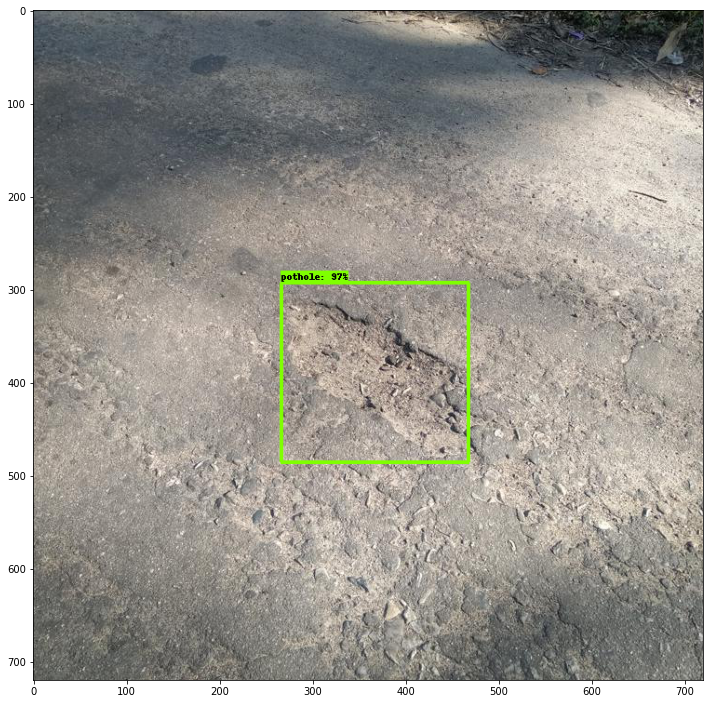

time: 5.45 s (started: 2021-01-13 15:08:45 +00:00)


In [ ]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
import random

TEST_IMAGE_PATHS = glob.glob('/content/test/test/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

# Things to try:
# Flip horizontally
# image_np = np.fliplr(image_np).copy()

# Convert image to grayscale
# image_np = np.tile(
#     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.show()

# **Pothole Detection on Scaled-YOLOV4 MODEL** 

In [ ]:
# clone Scaled_YOLOv4
!git clone https://github.com/WongKinYiu/ScaledYOLOv4.git  # clone repo
%cd /content/ScaledYOLOv4
#checkout the yolov4-large branch
!git checkout yolov4-large

Cloning into 'ScaledYOLOv4'...
remote: Enumerating objects: 118, done.
remote: Total 118 (delta 0), reused 0 (delta 0), pack-reused 118
Receiving objects: 100% (118/118), 337.30 KiB | 1.04 MiB/s, done.
Resolving deltas: 100% (48/48), done.
/content/ScaledYOLOv4
Branch 'yolov4-large' set up to track remote branch 'yolov4-large' from 'origin'.
Switched to a new branch 'yolov4-large'


In [ ]:
# check what files cloned from github
%ls

data/  detect.py  models/  README.md  test.py  train.py  utils/


In [ ]:
#install mish activation funciton for cuda on the GPU
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda
%cd mish-cuda
!python setup.py build install

/content
Cloning into 'mish-cuda'...
remote: Enumerating objects: 85, done.
remote: Counting objects: 100% (85/85), done.
remote: Compressing objects: 100% (71/71), done.
remote: Total 192 (delta 5), reused 80 (delta 4), pack-reused 107
Receiving objects: 100% (192/192), 208.06 KiB | 906.00 KiB/s, done.
Resolving deltas: 100% (54/54), done.
/content/mish-cuda
/usr/lib/python3.6/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
creating build
creating build/lib.linux-x86_64-3.6
creating build/lib.linux-x86_64-3.6/mish_cuda
copying src/mish_cuda/__init__.py -> build/lib.linux-x86_64-3.6/mish_cuda
running egg_info
creating src/mish_cuda.egg-info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
writing manifest file 'src/mish_c

In [ ]:
!pip install -U PyYAML

     |████████████████████████████████| 276kB 11.1MB/s 
  Created wheel for PyYAML: filename=PyYAML-5.3.1-cp36-cp36m-linux_x86_64.whl size=44621 sha256=ab8bd72ed601518a9d00f92f44f44809bd7d28fa246f9f934116e0668187804d
  Stored in directory: /root/.cache/pip/wheels/a7/c1/ea/cf5bd31012e735dc1dfea3131a2d5eae7978b251083d6247bd
Successfully built PyYAML
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
# Getting dataset downloaded from roboflow
%cd /content/

!curl -L "https://app.roboflow.com/ds/F6AobpXs5S?key=dyCthQkPMB" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1178      0 --:--:-- --:--:-- --:--:--  1177
100 46.0M  100 46.0M    0     0  14.6M      0  0:00:03  0:00:03 --:--:-- 37.1M
Archive:  roboflow.zip
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/img-105_jpg.rf.4487674f35709de27a50dfdcf2a48388.jpg  
 extracting: test/images/img-107_jpg.rf.1e9362e9bd19e573ba09c4ab9bc66cd0.jpg  
 extracting: test/images/img-146_jpg.rf.6a0eadde299d949777382ca2374d71fc.jpg  
 extracting: test/images/img-161_jpg.rf.bf4e220905622bcfab9cf7cb5b4f2124.jpg  
 extracting: test/images/img-168_jpg.rf.f2bdb86cc802d9a8286b25195b13e9af.jpg  
 extracting: test/images/img-179_jpg.rf.0a678db1a67b494b0d783e81437

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['pothole']

#Scaled-Yolov4 Model Configuration and Architecture


In [ ]:
%cat /content/ScaledYOLOv4/models/yolov4-csp.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bott

# Train Pothole Scaled-YOLOv4 Model Detector





In [ ]:
# train scaled-YOLOv4 on custom data for 
# time its performance
%%time
%cd /content/ScaledYOLOv4/
!python train.py --img 416 --batch 16 --epochs 50 --data '../data.yaml' --cfg ./models/yolov4-csp.yaml --weights '/runs/exp0_yolov4-csp-results/weights/' --name yolov4-p5-results  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov4-csp.yaml', data='../data.yaml', device='', epochs=50, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-p5-results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='/runs/exp0_yolov4-csp-results/weights/', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.5, 'scale': 0.8, 'shear': 0.0, 'perspective': 

# Evaluate Scaled-YOLOv4 Model Detector Performance

In [ ]:
# Start tensorboard
# Launch after training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

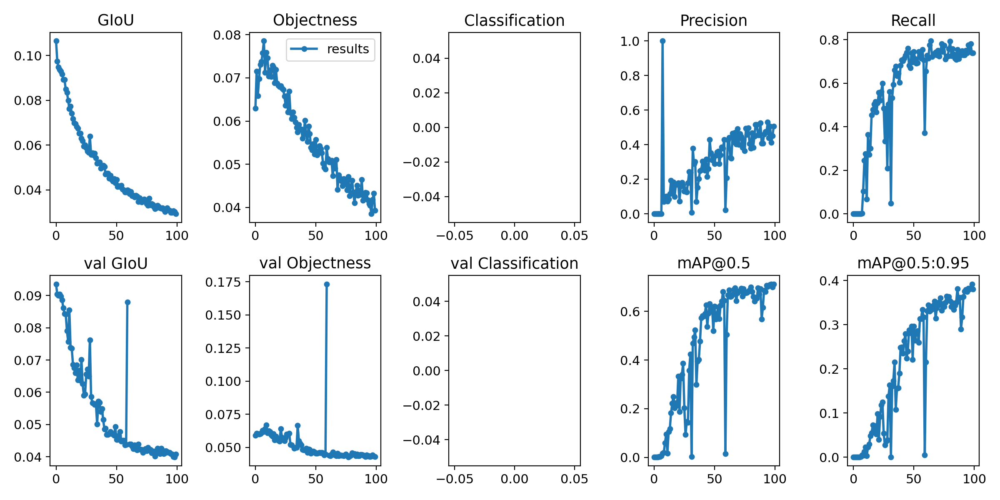

In [ ]:
# we can also output some older school graphs 
#from utils.general import plot_results  # plot results.txt as results.png
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp1_yolov4-csp-results/results.png'))  # view results.png

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-p5-results/test_batch0_gt.jpg', width=900)

GROUND TRUTH TRAINING DATA:


NameError: ignored

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-p5-results/train_batch0.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


NameError: ignored

#Run Inference  With Trained Weights


In [ ]:
# check weights saved after training
%cd  /content/drive/MyDrive/phase3/ScaledYOLOv4/runs/exp0_yolov4-p5-results/weights/
%ls

/content/drive/MyDrive/phase3/ScaledYOLOv4/runs/exp0_yolov4-p5-results/weights
best_yolov4-p5-results.pt        last_030.pt  last_042.pt
best_yolov4-p5-results_strip.pt  last_031.pt  last_043.pt
last_020.pt                      last_032.pt  last_044.pt
last_021.pt                      last_033.pt  last_045.pt
last_022.pt                      last_034.pt  last_046.pt
last_023.pt                      last_035.pt  last_047.pt
last_024.pt                      last_036.pt  last_048.pt
last_025.pt                      last_037.pt  last_049.pt
last_026.pt                      last_038.pt  last_yolov4-p5-results.pt
last_027.pt                      last_039.pt  last_yolov4-p5-results_strip.pt
last_028.pt                      last_040.pt
last_029.pt                      last_041.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/ScaledYOLOv4/
!python detect.py --weights ./runs/exp0_yolov4-p5-results/weights/best_yolov4-p5-results.pt --img 416 --conf 0.4 --source ../test/images

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['./runs/exp0_yolov4-p5-results/weights/best_yolov4-p5-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

Fusing layers... Model Summary: 235 layers, 5.24706e+07 parameters, 5.04494e+07 gradients
image 1/67 /content/test/images/img-105_jpg.rf.4487674f35709de27a50dfdcf2a48388.jpg: 416x416 1 potholes, Done. (0.025s)
image 2/67 /content/test/images/img-107_jpg.rf.1e9362e9bd19e573ba09c4ab9bc66cd0.jpg: 416x416 2 potholes, Done. (0.025s)
image 3/67 /content/test/images/img-146_jpg.rf.6a0eadde299d949777382ca2374d71fc.jpg: 416x416 1 potholes, Done. (0.025s)
image 4/67 /content/test/images/img-161_jpg.rf.bf4e220905622bcfab9cf7cb5b4f2124.jpg: 416x416 1 potholes, Done. (0.027s)
image 5/67 /content/test/

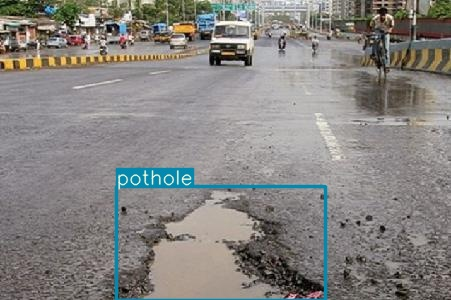

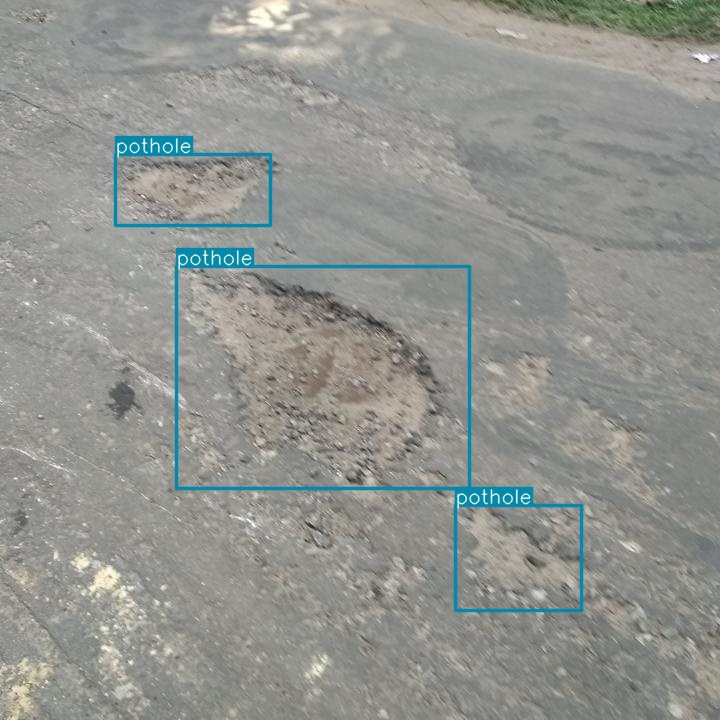

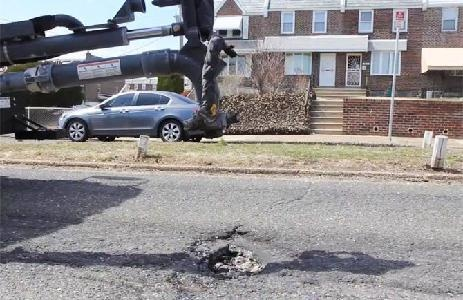

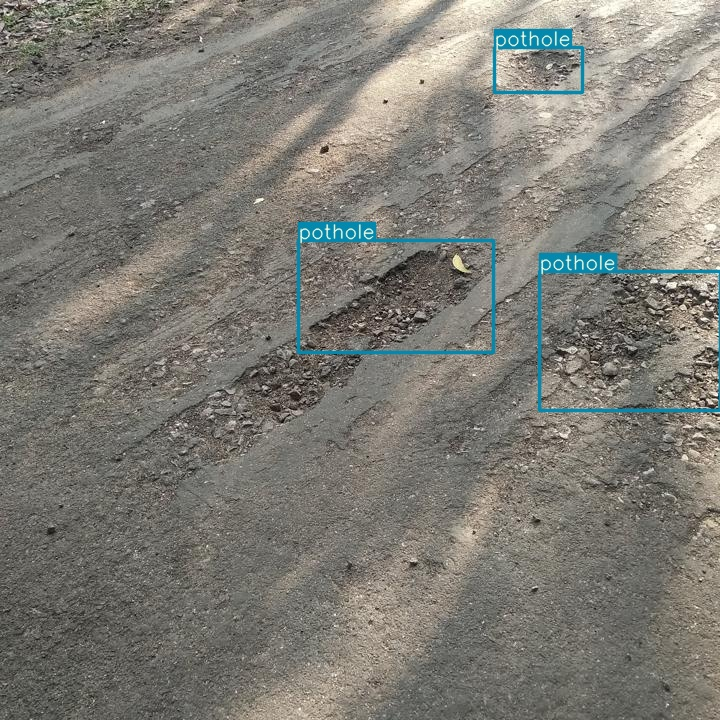

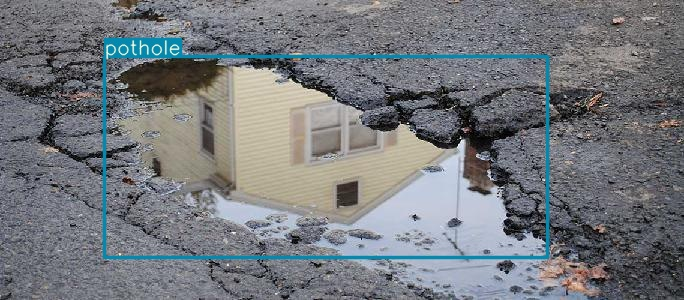

...

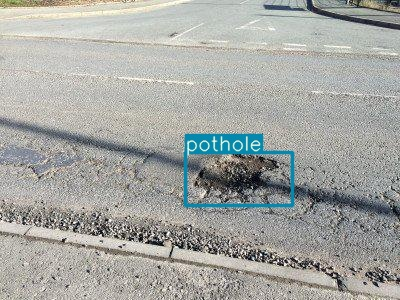

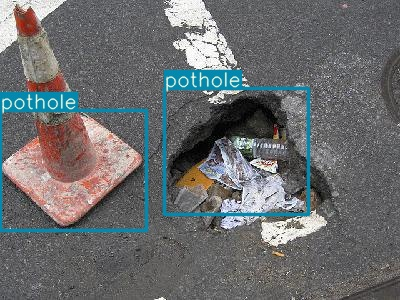

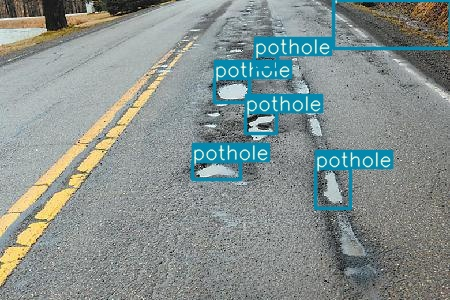

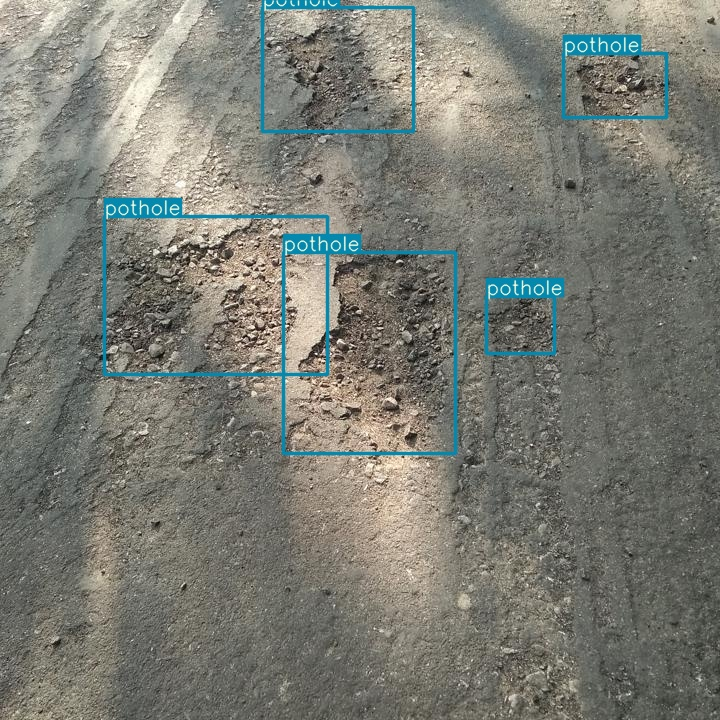

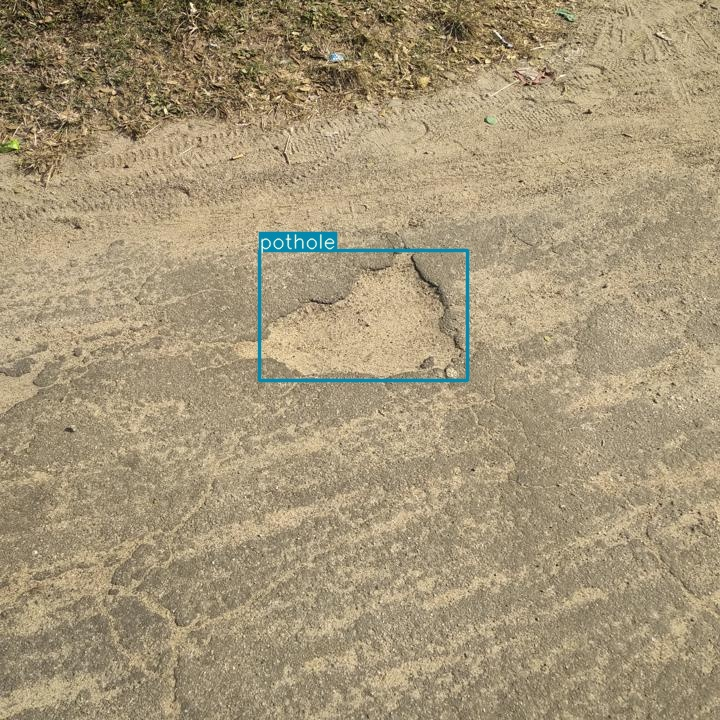

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('./inference/output/*.jpg'): # glob retrieves files and pathnames 
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

 export the trained weights you have made here for inference on other devices

In [ ]:
from google.colab import files
files.download('/content/ScaledYOLOv4/runs/exp2_yolov4-csp-results/weights/best_yolov4-csp-results.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **Useful Functions Snippets of Code**

In [ ]:
# read a csv file
import pandas as pd
df = pd.read_csv('/content/data/tryy.csv')
df.head

<bound method NDFrame.head of        filename   num_potholes  xmin  ymin  width  height  class
0   G0010033.jpg             6  1990  1406     66      14    NaN
1   G0010033.jpg             6  1464  1442     92      16    NaN
2  G0010033.jpg              6  1108  1450     54      16    NaN
3   G0010033.jpg             6   558  1434    102      16    NaN
4   G0010033.jpg             6   338  1450     72      18    NaN
5   G0010033.jpg             6   262  1450     58      22    NaN
6   G0010122.jpg             2  1960  1396     48      14    NaN
7   G0010122.jpg             2  1982  1342     36      10    NaN>

In [ ]:
# removing file directories with contents
from shutil import rmtree

rmtree('/content/test')

time: 34.3 ms (started: 2021-01-13 15:18:51 +00:00)


In [ ]:
#print path directory and list files
import os 
path=os.getcwd()
print(path)
%ls

In [ ]:
# upload files to google colaboratory
from google.colab import files

uploaded = files.upload()

KeyboardInterrupt: ignored

In [ ]:
#download files
from google.colab import files
files.download('example.txt')

In [ ]:
#copy a file to a folder
!cp example.txt /content/drive/MyDrive

In [ ]:
#removing directories with contents in
# removing file directories with contents
from shutil import rmtree

rmtree('/content/extract/Dataset 2 (Complex)')

In [ ]:
# moving files or folders
import shutil as s 
s.move("path/to/current/file", "path/to/new/destination/for/file")

In [ ]:
 #!python generate_tfrecord.py --csv_input=/content/data/tryy.csv  --output_path=/content/train.record
 !python generate_tfrecord.py --csv_input=/content/data/tryy.csv --image_dir=/content/data/train --output_path=/content/train.record

2021-01-14 16:41:52.165325: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
       filename  ...    class
0  G0010033.JPG  ...  pothole
1  G0010033.JPG  ...  pothole
2  G0010033.JPG  ...  pothole
3  G0010033.JPG  ...  pothole
4  G0010033.JPG  ...  pothole
5  G0010033.JPG  ...  pothole
6  G0010122.JPG  ...  pothole
7  G0010122.JPG  ...  pothole

[8 rows x 7 columns]
Index(['filename', 'num_potholes', 'xmin', 'ymin', 'width', 'height', 'class'], dtype='object')
Successfully created the TFRecords: /content/train.record


In [ ]:
import os
os.getcwd()

'/content'